# Destretching time-series images with FLCT

Ground-based observations of the sun suffer from atmospheric "seeing" distortions, which are typically non-uniform across the field of view. To remove these distortions and enable analysis of, e.g., surface flows and sub-pixel localizations of small-scale features, the data must be destretched; that is, the distortions from the atmosphere must be undone.

To do this, we will use Fourier Local Correlation Tracking (FLCT). Essentially, we break up the image into subfields, and compare each subfield with its counterpart in a reference image. For each subfield, we compute the Fourier transform, and take the inner product with its reference counterpart. The product of the two Fourier transforms will have a global maximum at low spatial frequencies; if the subfield and its reference counterpart were perfectly aligned, that peak would be exactly at the origin. If the peak is offset, then the magnitude and direction of that offset is exactly the displacement of the subfield from the reference. Doing this for every subfield produces a vector map, which can be interpolated across the whole image; applying those shifts thus destretches the image to match the reference frame.

In [4]:
# Import necessary tools and functions.
from astropy.io import fits
from destretch import *
from matplotlib.animation import FuncAnimation
from IPython import display
pl.rcParams['animation.ffmpeg_path'] = '/usr/bin/ffmpeg'

In [42]:
# Get test data from FITS file.
Hdu = fits.open("test/test.fits")
test_data = Hdu[0].data
test_data /= np.mean(test_data)
med = np.median(test_data, axis=0)

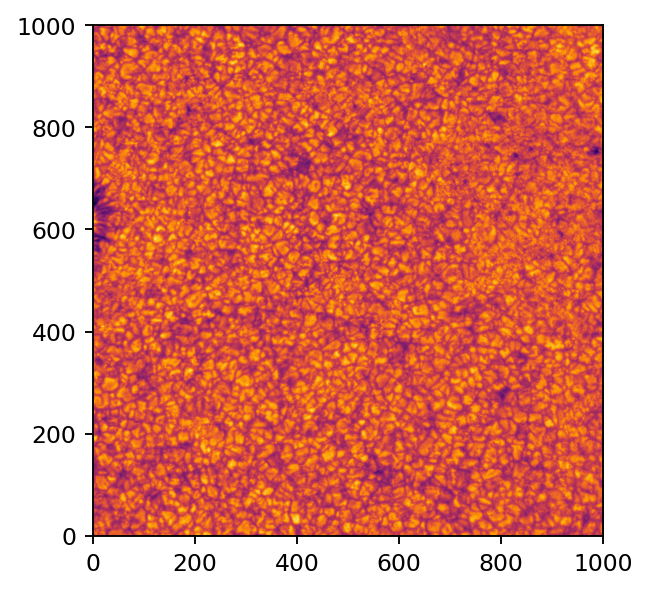

In [47]:
# Visualize test data as an animation.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(test_data[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(test_data[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [48]:
# Display the animation as a JavaScript widget.
# Note how the image "jitters" from frame to frame; this is what we want to remove.
display.HTML(anim.to_jshtml())

In [66]:
# Perform destretching for each frame, using median as reference.
kernel_sizes = [128, 64, 32, 16]
reference = np.median(test_data, axis=0)
#reference = test_data[5]
ans = np.zeros(test_data.shape)

for i in range(11):
    scene = test_data[i]
    ans[i], disp, rdisp, d_info = reg_loop(scene, reference, kernel_sizes)

Total destr took: 0.2655470371246338 seconds for kernel of size 128 px.
Total destr took: 0.36586785316467285 seconds for kernel of size 64 px.
Total destr took: 0.4572892189025879 seconds for kernel of size 32 px.
Total destr took: 1.0189297199249268 seconds for kernel of size 16 px.
Total elapsed time 4.555697441101074 seconds.
Total destr took: 0.27341318130493164 seconds for kernel of size 128 px.
Total destr took: 0.3322732448577881 seconds for kernel of size 64 px.
Total destr took: 0.3216407299041748 seconds for kernel of size 32 px.
Total destr took: 1.022446632385254 seconds for kernel of size 16 px.
Total elapsed time 4.089638710021973 seconds.
Total destr took: 0.18928766250610352 seconds for kernel of size 128 px.
Total destr took: 0.2674434185028076 seconds for kernel of size 64 px.
Total destr took: 0.32959556579589844 seconds for kernel of size 32 px.
Total destr took: 0.6813983917236328 seconds for kernel of size 16 px.
Total elapsed time 3.138132333755493 seconds.
Tota

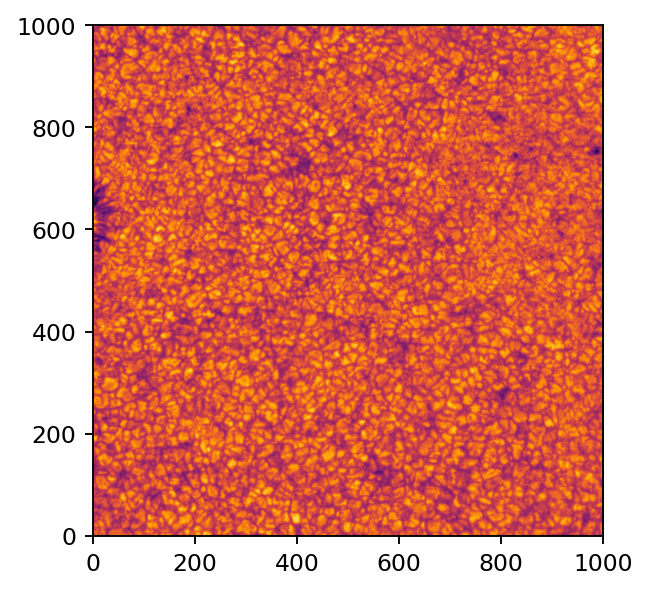

In [67]:
# Create another animation to visualize the destretched data.
fig = pl.figure(figsize=(5,4), dpi=169)
ax = pl.subplot(111)
im = pl.imshow(ans[0], origin='lower', cmap='inferno')
title = ax.set_title('')
ax.set_xlim(0, 1000)
ax.set_ylim(0, 1000)

def draw(n):
    im.set_data(ans[n])
    title.set_text(f'frame {n}')
    return im

anim = FuncAnimation(fig, draw, frames=11, interval=100)

In [68]:
# Once again, we display the animation as a JS widget.
# The "jitter" has been greatly reduced, but some small-scale distortions remain.
display.HTML(anim.to_jshtml())